This notebook demonstrates performance of mSSA model. It also saves/loads some data and figures. Model's parameters can be changed in the corresponding sections here.

In [1]:
# add path to ssa package
import sys
sys.path.append('../../..')

In [2]:
import numpy as np
import scipy.linalg as linalg
from matplotlib import pyplot as plt
import pandas as pd
import pathlib

import pickle

%matplotlib inline 

In [3]:
# mssa model
from src.ssa_methods.m_ssa import m_SSA

# plot with large fonts and other stuff
from src.plot.journal_style import EnableJournalStylePlotting

# data extraction methods
from src.data.accelerometer import GetMotionData

## Data preprocessing

In [4]:
# names of observed signals
sig_names = ['$a_x$', '$a_y$', '$a_z$', '$w_x$', '$w_y$', '$w_z$']
# measure units
# acceleration is in g-units (g=9.8)
sig_units = ["g", "g", "g", "rad/s", "rad/s", "rad/s"]

num_signals = 6

In [5]:
# retrive signals and corresponding time grids
# this is walking motion
# first 3 components = accelerometer, last 3 - gyroscope
(train_data, time_grid_train), (test_data, time_grid_test) = GetMotionData()

print("Train len = ", train_data.shape[0])
print("Test len = ", test_data.shape[0])

Train len =  2460
Test len =  540


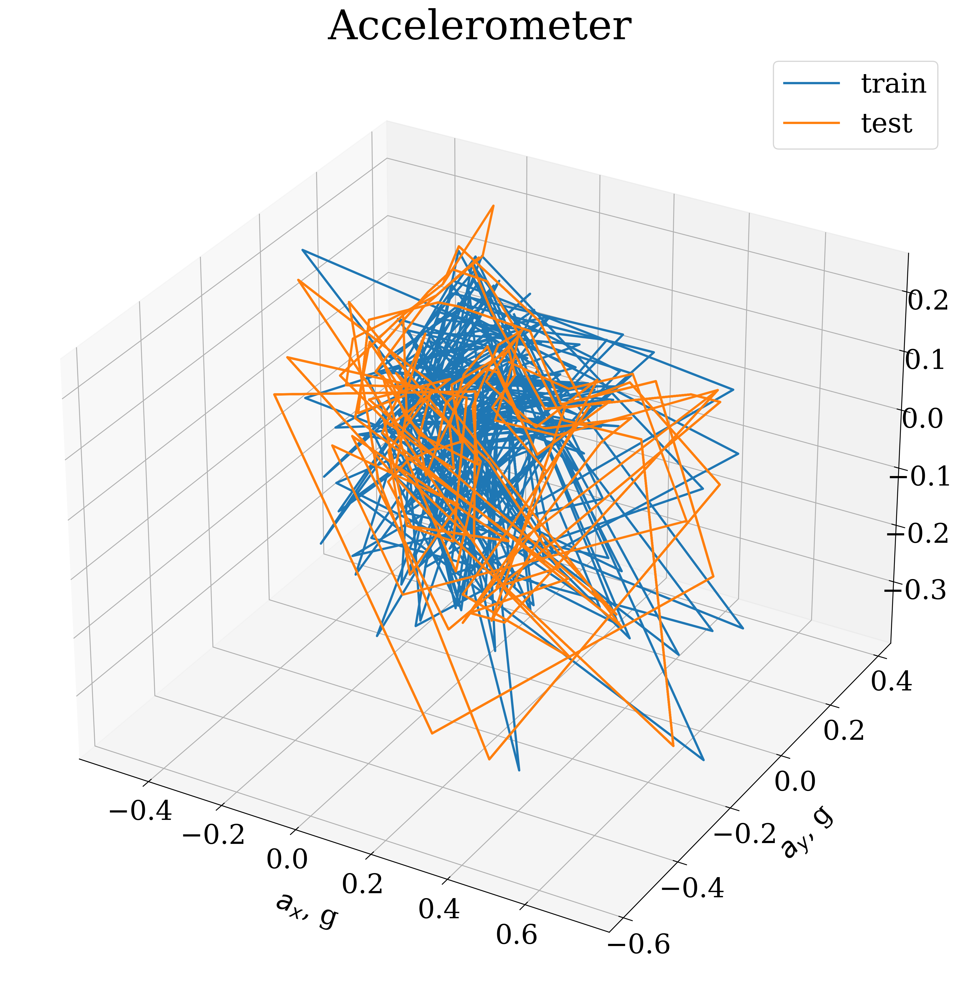

In [6]:
# draw accelerometer signals
with EnableJournalStylePlotting():
    fig = plt.figure(figsize=(20, 15))
    ax = fig.add_subplot(projection='3d')

    train_points = train_data.T[:3, ::10]
    test_points = test_data.T[:3, ::2]

    ax.plot(*train_points, label="train")
    ax.plot(*test_points, label="test")

    ax.set_xlabel(f"{sig_names[0]}, {sig_units[0]}", labelpad=21)
    ax.set_ylabel(f"{sig_names[1]}, {sig_units[1]}", labelpad=21)
    ax.set_zlabel(f"{sig_names[2]}, {sig_units[2]}", labelpad=21)
    ax.set_title("Accelerometer")
    ax.legend()

    fig.savefig("../../../figs/acceleromter.png", format='png')

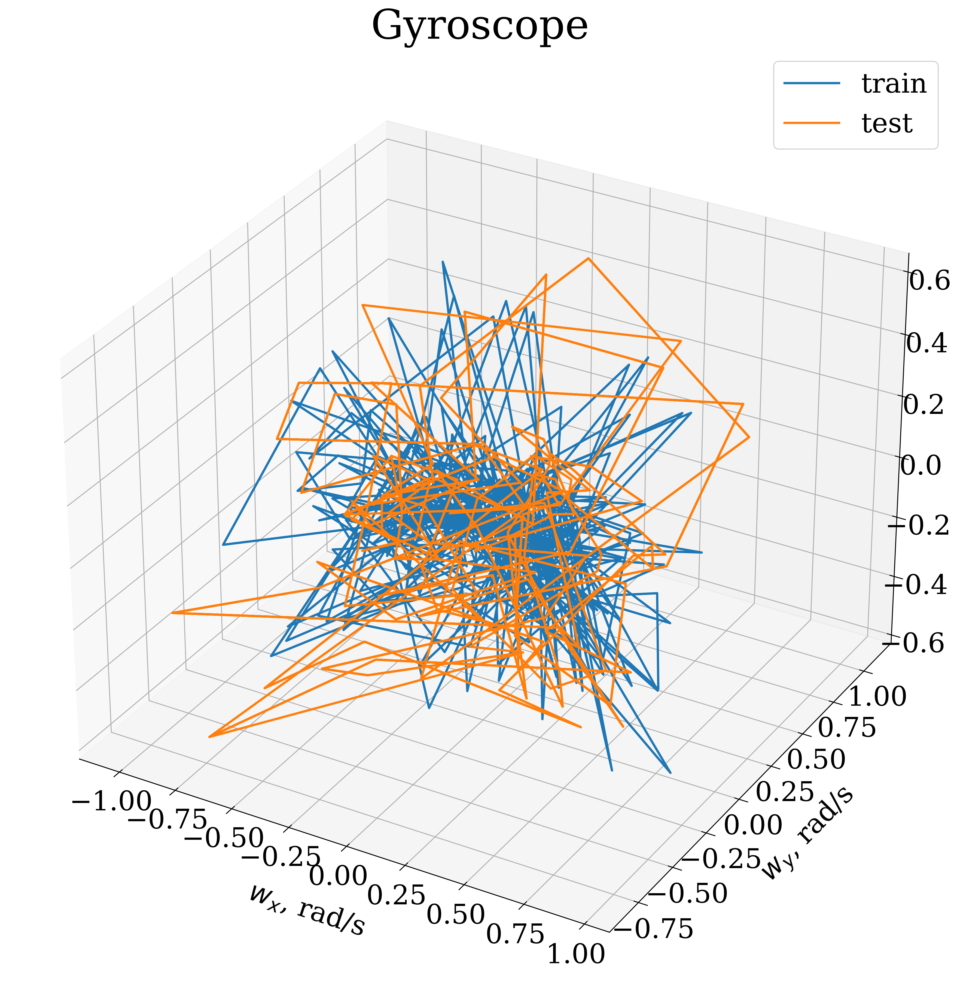

In [7]:
# draw gyro signals
with EnableJournalStylePlotting():
    fig = plt.figure(figsize=(20, 15))
    ax = fig.add_subplot(projection='3d')

    train_points = train_data.T[3:, ::10]
    test_points = test_data.T[3:, ::2]

    ax.plot(*train_points, label="train")
    ax.plot(*test_points, label="test")

    ax.set_xlabel(f"{sig_names[3]}, {sig_units[3]}", labelpad=21)
    ax.set_ylabel(f"{sig_names[4]}, {sig_units[4]}", labelpad=21)
    ax.set_zlabel(f"{sig_names[5]}, {sig_units[5]}", labelpad=21)
    ax.set_title("Gyroscope")
    ax.legend()

    fig.savefig("../../../figs/gyro.png", format='png')

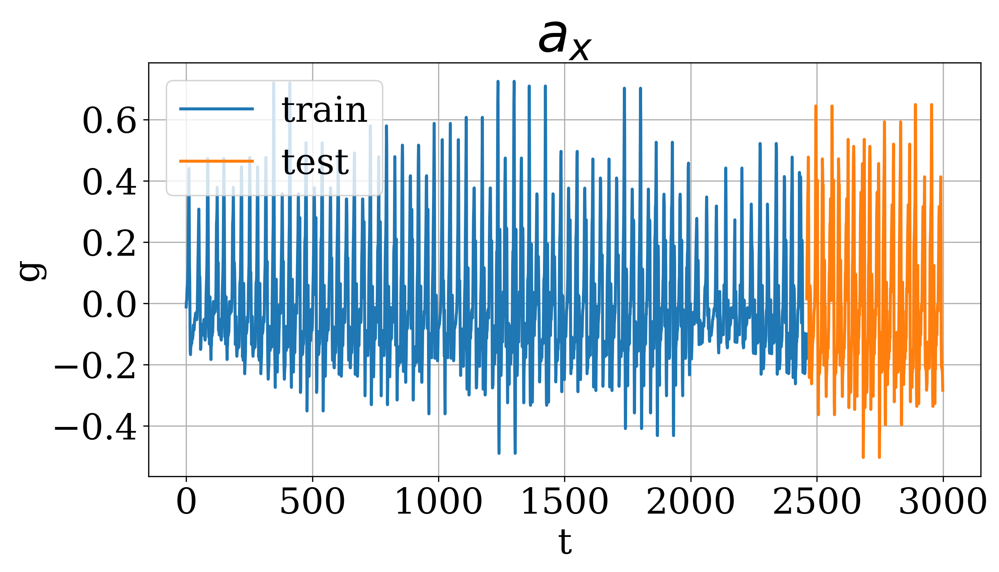

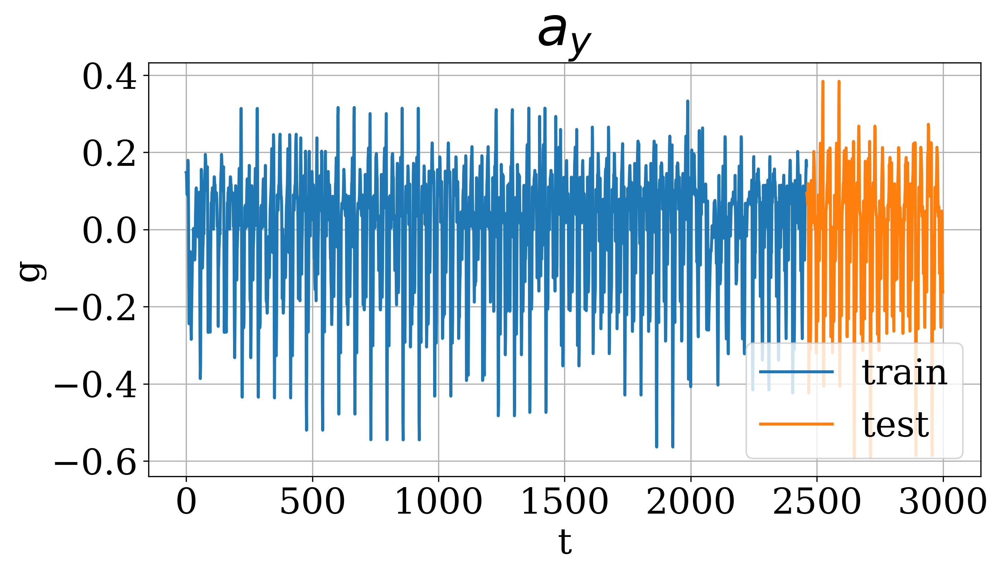

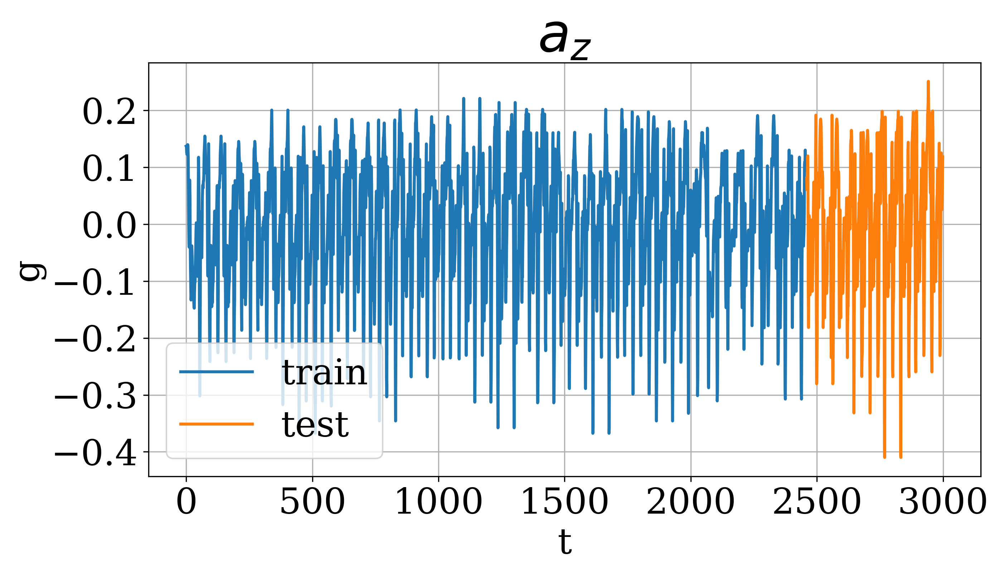

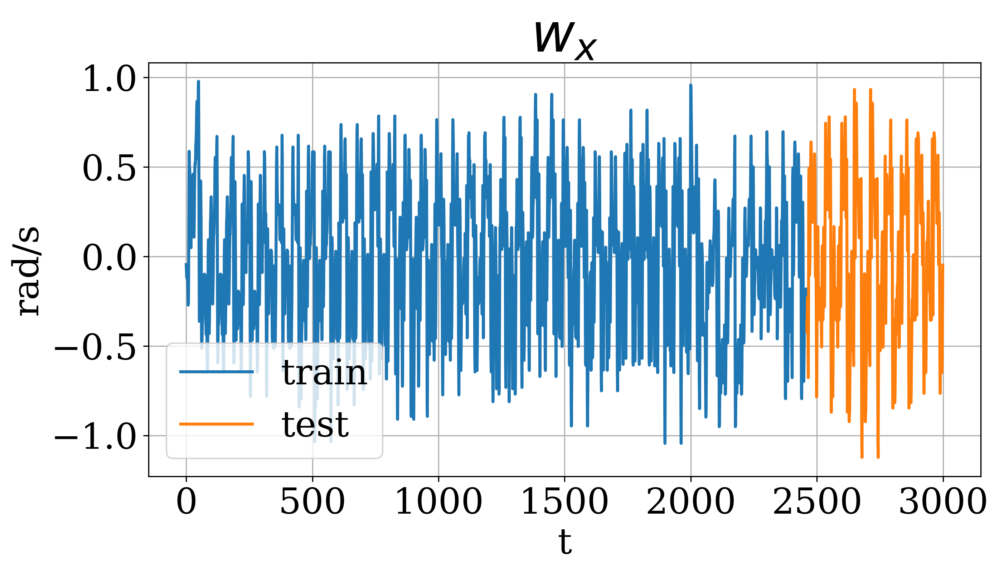

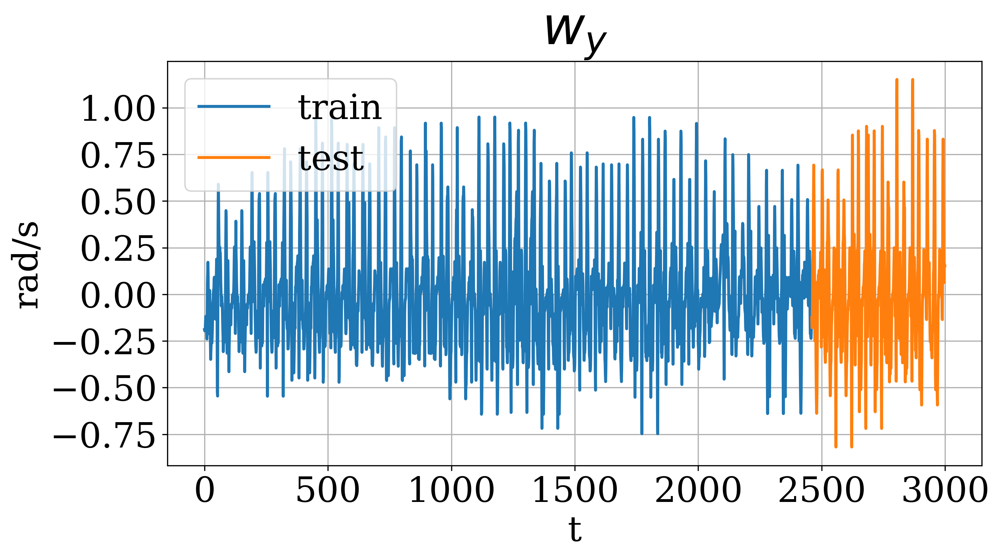

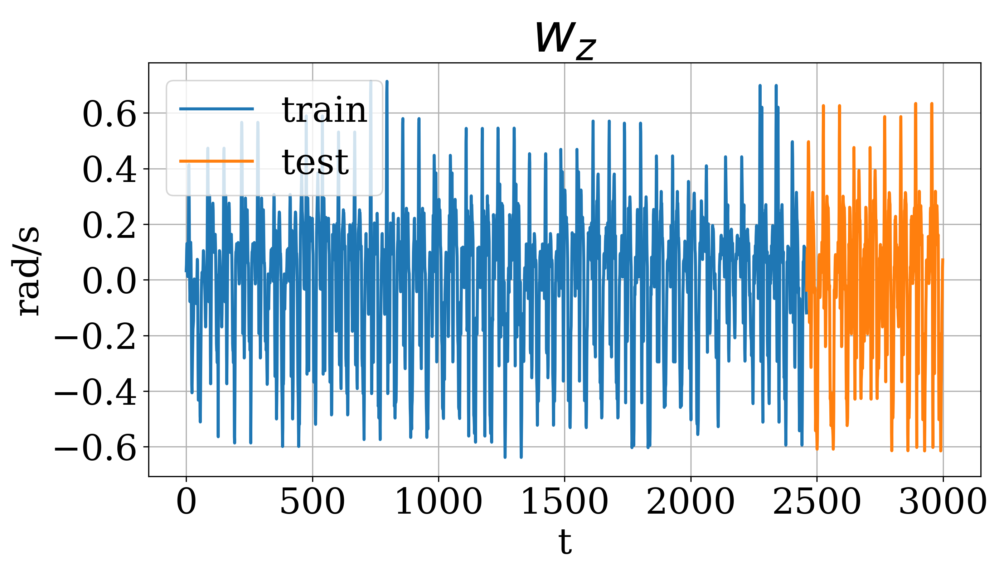

In [8]:
# draw signals
for i in range(num_signals):
    with EnableJournalStylePlotting():
        fig, ax = plt.subplots(figsize=(10, 5))

        ax.plot(time_grid_train, train_data.T[i], label='train')
        ax.plot(time_grid_test, test_data.T[i], label='test')

        ax.grid(True)
        ax.legend()
        ax.set_xlabel('t')
        ax.set_ylabel(sig_units[i])
        ax.set_title(sig_names[i])

        fig.savefig(f"../../../figs/{sig_names[i]}.png", format='png')

## Global method parameters

In [9]:
# aka L parameter
ssa_window_size = 500

## mSSA fitting

In [10]:
# make directory for models
pathlib.Path(f'./saved_model').mkdir(parents=True, exist_ok=True)

In [11]:
# load model if it already exists
if pathlib.Path(f'./saved_model/mssa_model.pkl').exists():
    with open(f'./saved_model/mssa_model.pkl', 'rb') as f:
        m_ssa_obj = pickle.load(f)
else:
    m_ssa_obj = m_SSA(ssa_window_size, train_data.T)

    # make svd for common matrix, extract factors and singular values
    m_ssa_obj.decompose_tt()

    # save model
    with open(f'./saved_model/mssa_model.pkl', 'wb') as f:
        pickle.dump(m_ssa_obj, f)

Text(0, 0.5, '$\\sigma$')

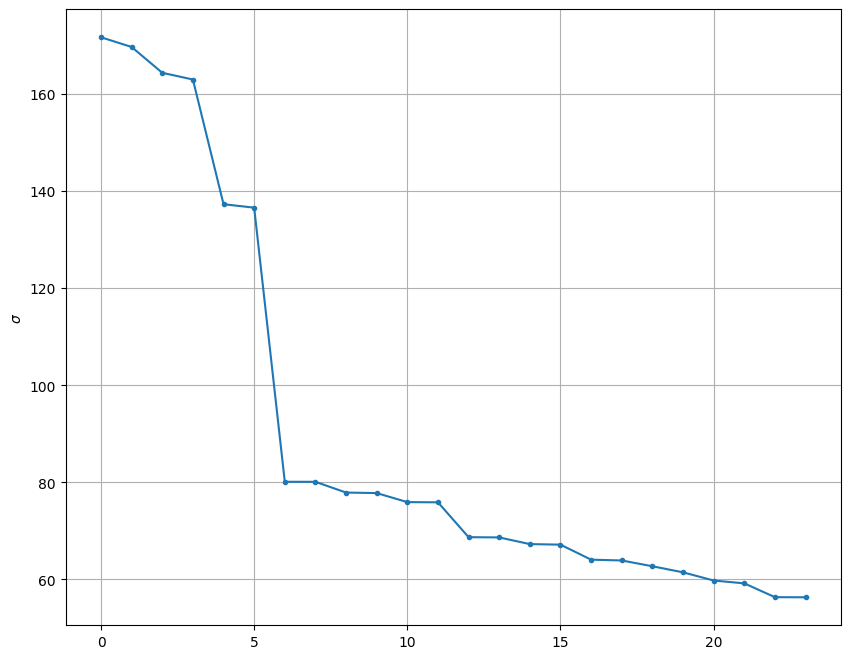

In [17]:
fig, ax = plt.subplots(figsize=(10, 8))

ax.plot(m_ssa_obj.weights[:24], marker='.')

ax.grid(True)
ax.set_ylabel("$\sigma$")

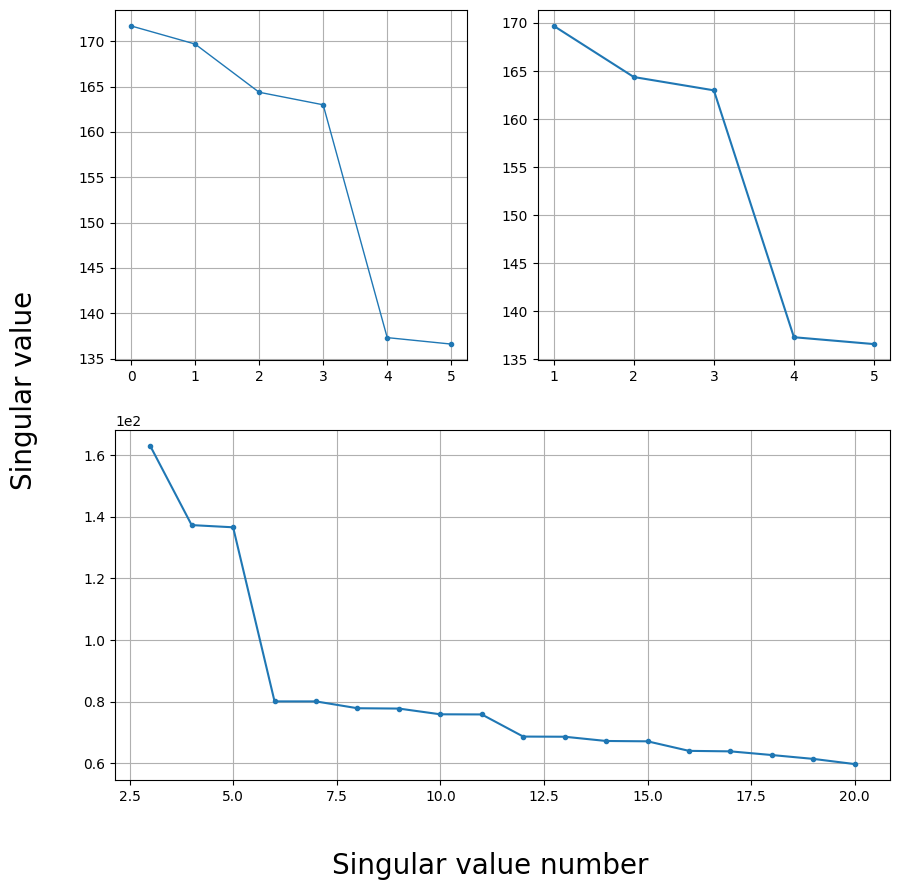

In [12]:
# have a look on singular values on diffrent scales
fig, axd = plt.subplot_mosaic([['left', 'right'], ['down', 'down']],figsize=(10, 10))

# put first 5 singular values on the left
axd['left'].plot(np.arange(0, 5 + 1), m_ssa_obj.weights[:5 + 1], marker='.', linewidth=1)
axd['left'].grid(True)

# put 2-5 singular values on the right
axd['right'].plot(np.arange(1, 5 + 1), m_ssa_obj.weights[1:5 + 1], marker='.')
axd['right'].grid(True)

# put 3-20 singular values on the right
axd['down'].plot(np.arange(3, 20 + 1, dtype=np.int16), m_ssa_obj.weights[3:20 + 1], marker='.')
axd['down'].grid(True)
axd['down'].ticklabel_format(style='sci', axis='y', scilimits=(0,0))

fig.supxlabel('Singular value number', fontsize=20)
fig.supylabel('Singular value', fontsize=20);

In [18]:
# how many value do first k singular values keep
print(f'Value of first {24} sing.vals. store {linalg.norm(m_ssa_obj.weights[:24], ord=2) / linalg.norm(m_ssa_obj.weights, ord=2)} information')

Value of first 24 sing.vals. store 0.8144311735968072 information


Let's keep first 24 components

In [19]:
m_ssa_obj.dispose_factors(np.arange(24, len(m_ssa_obj.weights)))

0.5802601687809766

## Decomposition

In [20]:
# colours for our signals (https://colorhunt.co/palette/808836ffbf00ff9a00d10363)
color_list = ['#808836', '#FFBF00', '#FF9A00', "#D10363", "#6C0345", "#DC6B19"]

In [21]:
def FitAndDescribe(groups: list):
    """fit mssa object with grouping, print hankel residuals, plot signal's components

    Args:
        groups (list): 
    Returns: components figures
    """
    for i in range(train_data.shape[1]):
        m_ssa_obj.set_factors_grouping(groups[i], i)

    comp_sigs, hank_resid_abs, hank_resid_rel = m_ssa_obj.decompose_signals()

    # view relative hankerlization errors
    for i in range(train_data.shape[1]):
        print(f'Group for {sig_names[i]}: {groups[i]}')
        print(f'Rel hankel. errors for {sig_names[i]}\n{hank_resid_rel[i].tolist()}\nMean = {np.mean(hank_resid_rel[i])}\n')

    figs_container = []

    # plot results
    for i in range(train_data.shape[1]):
        with EnableJournalStylePlotting():
            fig, axs = plt.subplots(nrows=len(comp_sigs[i]), ncols=1, figsize=(15, 8))
            figs_container.append(fig)
    
            for j in range(len(comp_sigs[i])):
                axs[j].plot(time_grid_train, comp_sigs[i][j], label=f'Component {j + 1}', color=color_list[i])
    
                if j != len(comp_sigs[i]) - 1:
                    axs[j].tick_params(axis='x', labelsize=0)
    
                axs[j].grid(True)
                axs[j].legend()
    
            fig.supylabel(f'{sig_units[i]}', fontsize=20)
            fig.supxlabel('$t$', fontsize=20)
            fig.suptitle(f'{sig_names[i]}', fontsize=30)
    
    return figs_container

### Manual singular values grouping 1

In [22]:
# make directory for figures
pathlib.Path(f'./figs/decomposition/manual').mkdir(parents=True, exist_ok=True)

# make directory for groupings
pathlib.Path(f'./saved_grouping/manual').mkdir(parents=True, exist_ok=True)

Group for $a_x$: [[0, 1], [2, 3], [6, 7, 8, 9, 10, 11], [12, 13, 14, 15], [16, 17, 18, 19], [20, 21], [22, 23]]
Rel hankel. errors for $a_x$
[0.9020711682127807, 0.24263167768057742, 0.4646230787605666, 0.43298202267190344, 0.7671693617182892, 0.8583315006825386, 0.4850096621582589]
Mean = 0.593259781697845

Group for $a_y$: [[0, 1], [2, 3], [6, 7, 8, 9, 10, 11], [12, 13, 14, 15], [16, 17, 18, 19], [20, 21], [22, 23]]
Rel hankel. errors for $a_y$
[0.8753053664022031, 0.23372937171365646, 0.5368251953004368, 0.4930673707187406, 0.6659606542554719, 0.8723614738968549, 0.47448185612694155]
Mean = 0.5931044697734722

Group for $a_z$: [[0, 1], [2, 3], [6, 7, 8, 9, 10, 11], [12, 13, 14, 15], [16, 17, 18, 19], [20, 21], [22, 23]]
Rel hankel. errors for $a_z$
[0.28030900493067334, 0.2877020702934441, 0.49920993846154443, 0.4912340382955044, 0.6463963028785826, 0.8569467413272454, 0.7765239315441682]
Mean = 0.548331718247309

Group for $w_x$: [[0, 1], [2, 3], [6, 7, 8, 9, 10, 11], [12, 13, 14, 

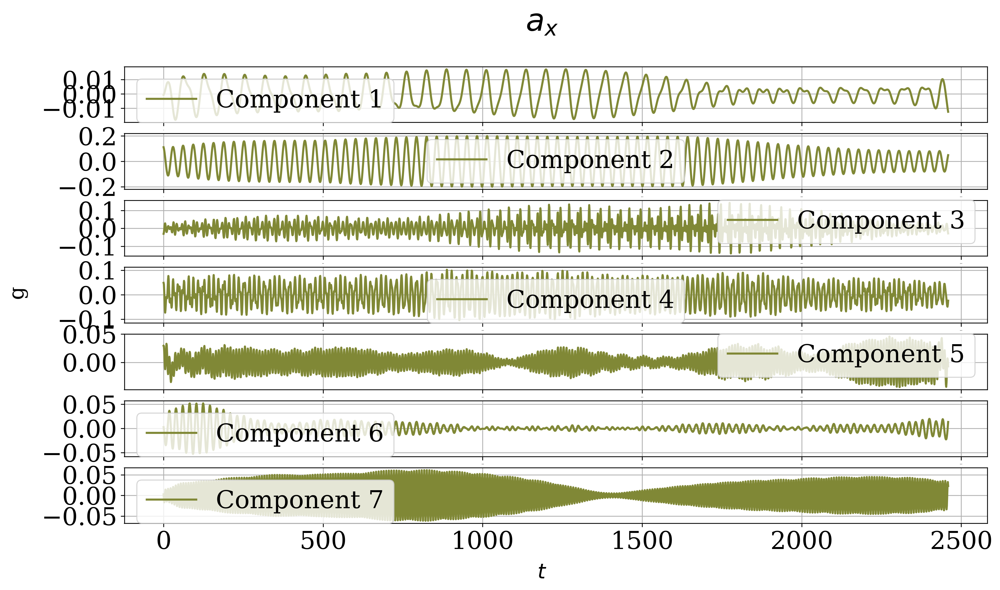

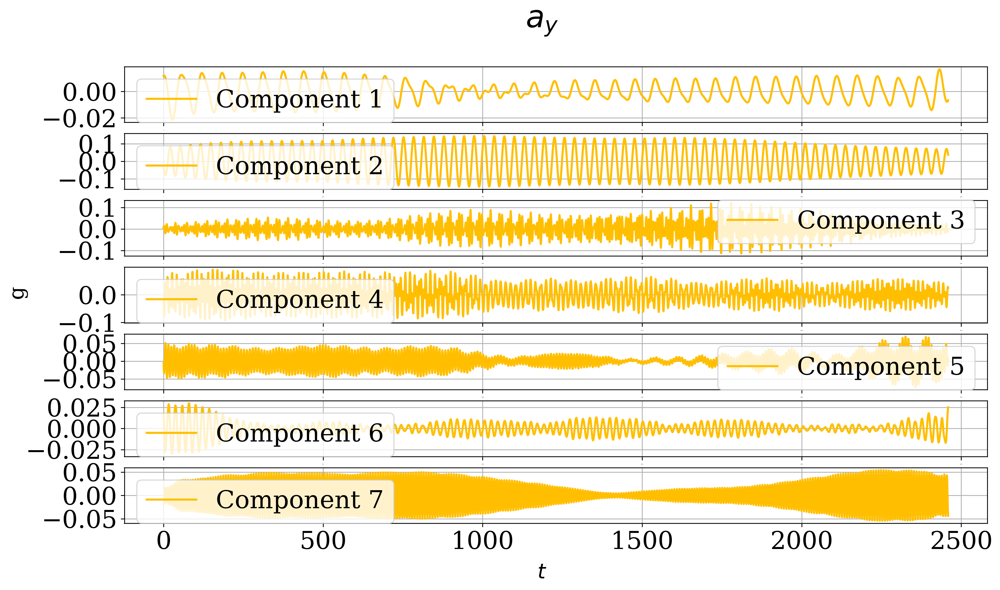

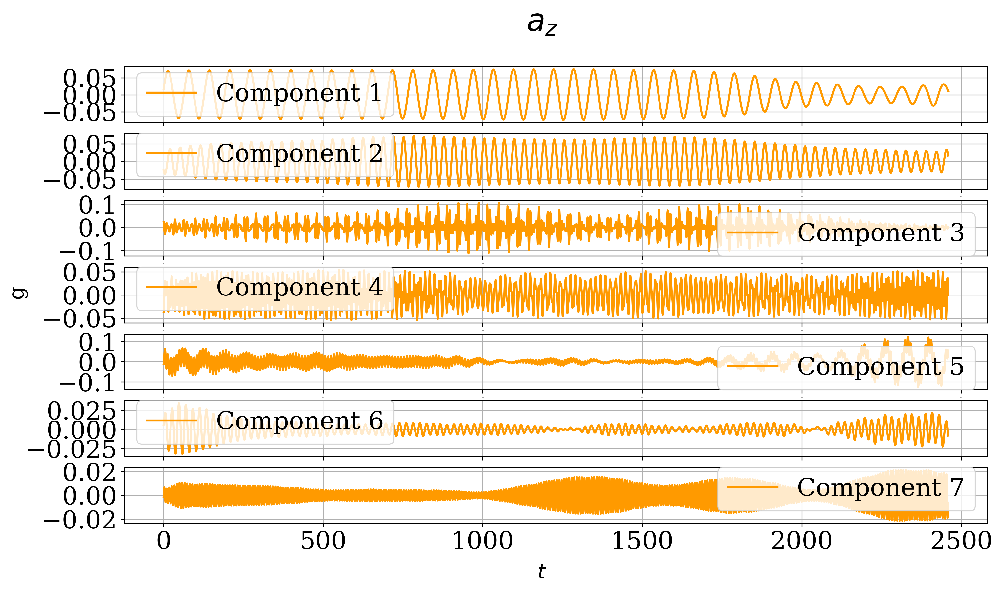

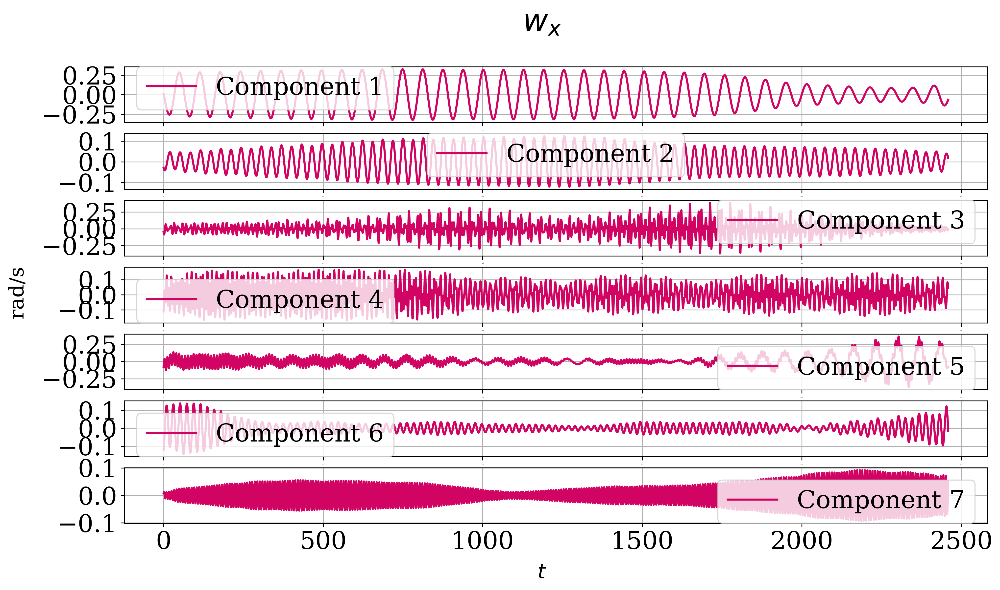

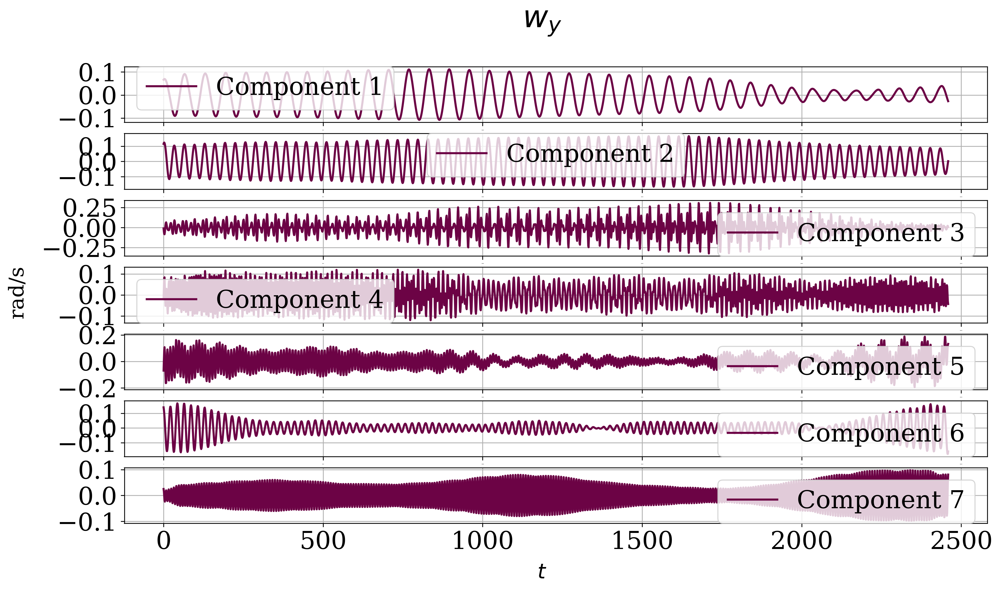

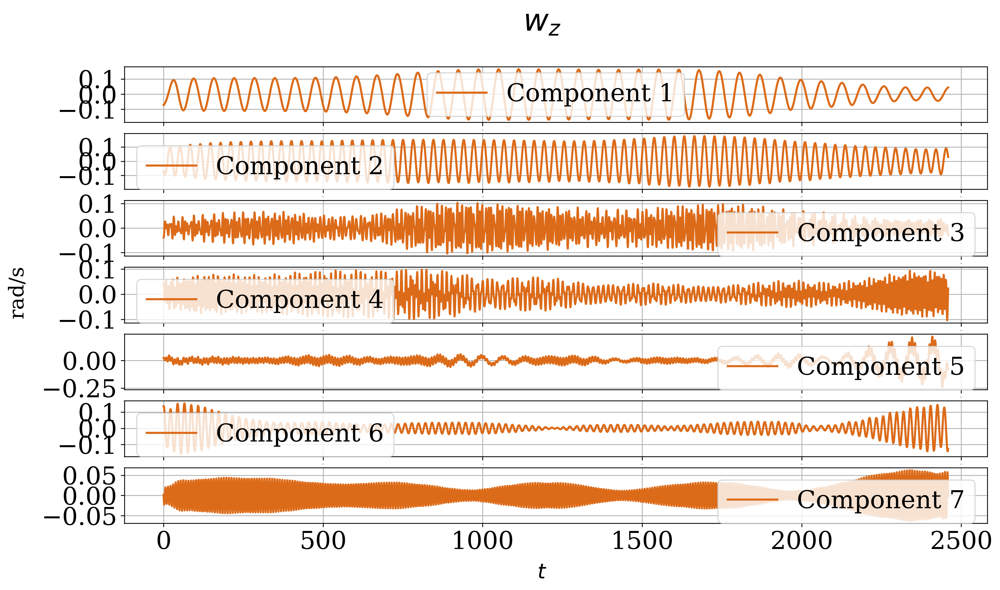

In [23]:
# every signal has the same grouping
my_grouping = [[[0, 1], [2, 3], [4, 5], list(range(6, 11 + 1)), 
                list(range(12, 15 + 1)), list(range(16, 19 + 1)), [20, 21], [22, 23]] for _ in range(num_signals)]
my_grouping_id = 1

component_figs = FitAndDescribe(my_grouping)

# make directory for figures for chosen grouping
pathlib.Path(f'./figs/decomposition/manual/grouping_{my_grouping_id}').mkdir(parents=True, exist_ok=True)

# save figures
for i in range(len(component_figs)):
    component_figs[i].savefig(
        f'./figs/decomposition/manual/{my_grouping_id}/{sig_names[i].replace(" ", "_")}.png',
        format='png'
    )

In [43]:
# save chosen grouping
with open(f'./saved_grouping/manual/grouping_{my_grouping_id}.pkl', 'wb') as f:
    pickle.dump(my_grouping, f)

In [ ]:
# plot 3d acceler results
for i in range(train_data.shape[1]):
    m_ssa_obj.set_factors_grouping(my_grouping[i], i)

comp_sigs, hank_resid_abs, hank_resid_rel = m_ssa_obj.decompose_signals()

with EnableJournalStylePlotting():
    num_components = len(my_grouping[0])
    for j in range(num_components):
        fig = plt.figure(figsize=(20, 15))
        ax = fig.add_subplot(projection='3d')

        component_points = np.array([comp_sigs[0][j], comp_sigs[1][j], comp_sigs[2][j]])

        ax.plot(*component_points)

        ax.set_xlabel(f"{sig_names[0]}, {sig_units[0]}", labelpad=21)
        ax.set_ylabel(f"{sig_names[1]}, {sig_units[1]}", labelpad=21)
        ax.set_zlabel(f"{sig_names[2]}, {sig_units[2]}", labelpad=21)
        ax.set_title(f"Component {j + 1}")

        for axis in ["x", "y", "z"]:
            ax.ticklabel_format(axis=axis, style="scientific", scilimits=(0, 0))
        
        fig.savefig(f"./figs/decomposition/manual/grouping_{my_grouping_id}/acceler_{j + 1}.png", format='png')

In [ ]:
# plot 3d gyro results

with EnableJournalStylePlotting():
    num_components = len(comp_sigs[0])
    for j in range(num_components):
        fig = plt.figure(figsize=(20, 15))
        ax = fig.add_subplot(projection='3d')

        component_points = np.array([comp_sigs[3][j], comp_sigs[4][j], comp_sigs[5][j]])
        #component_points = component_points[:, :50]

        ax.plot(*component_points,)

        ax.set_xlabel(f"{sig_names[3]}, {sig_units[3]}", labelpad=21)
        ax.set_ylabel(f"{sig_names[4]}, {sig_units[4]}", labelpad=21)
        ax.set_zlabel(f"{sig_names[5]}, {sig_units[5]}", labelpad=21)

        for axis in ["x", "y", "z"]:
            ax.ticklabel_format(axis=axis, style="scientific", scilimits=(0, 0))
        
        fig.savefig(f"./figs/decomposition/manual/grouping_{my_grouping_id}/gyro_{j + 1}.png", format='png')

### Manual singular values grouping 2

In [44]:
m_ssa_obj = m_SSA(ssa_window_size, train_data.T)

# make svd for common matrix, extract factors and singular values
m_ssa_obj.decompose_tt()
# save model
with open(f'./saved_model/mssa_model_1.pkl', 'wb') as f:
    pickle.dump(m_ssa_obj, f)

m_ssa_obj.dispose_factors(np.arange(6, len(m_ssa_obj.weights)))

0.7589130505978731

In [45]:
# save chosen grouping
with open(f'./saved_grouping/manual/grouping_{my_grouping_id}.pkl', 'wb') as f:
    pickle.dump(my_grouping, f)

Group for $a_x$: [[0, 1], [2, 3], [4, 5]]
Rel hankel. errors for $a_x$
[0.9020711682127807, 0.24263167768057742, 0.3832268607407331]
Mean = 0.5093099022113637

Group for $a_y$: [[0, 1], [2, 3], [4, 5]]
Rel hankel. errors for $a_y$
[0.8753053664022031, 0.23372937171365646, 0.36025449506896645]
Mean = 0.4897630777282753

Group for $a_z$: [[0, 1], [2, 3], [4, 5]]
Rel hankel. errors for $a_z$
[0.28030900493067334, 0.2877020702934441, 0.3290939933935575]
Mean = 0.2990350228725583

Group for $w_x$: [[0, 1], [2, 3], [4, 5]]
Rel hankel. errors for $w_x$
[0.23246731673496934, 0.4180972656806133, 0.3818430604725206]
Mean = 0.3441358809627011

Group for $w_y$: [[0, 1], [2, 3], [4, 5]]
Rel hankel. errors for $w_y$
[0.33424713068249134, 0.2613943108086112, 0.30164256856733457]
Mean = 0.29909467001947904

Group for $w_z$: [[0, 1], [2, 3], [4, 5]]
Rel hankel. errors for $w_z$
[0.28608203783039343, 0.27323296819592996, 0.3219337465808617]
Mean = 0.29374958420239505



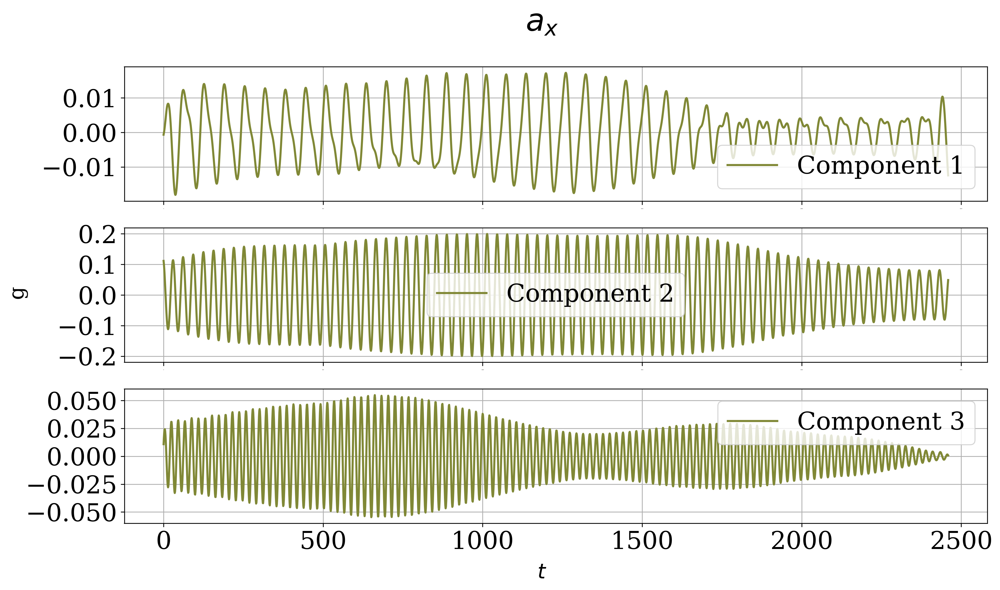

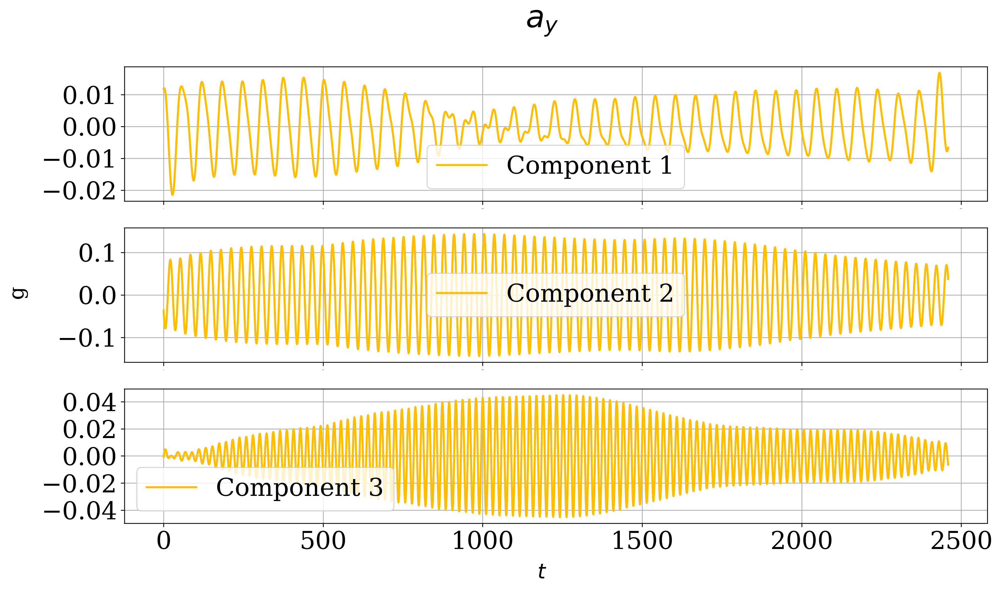

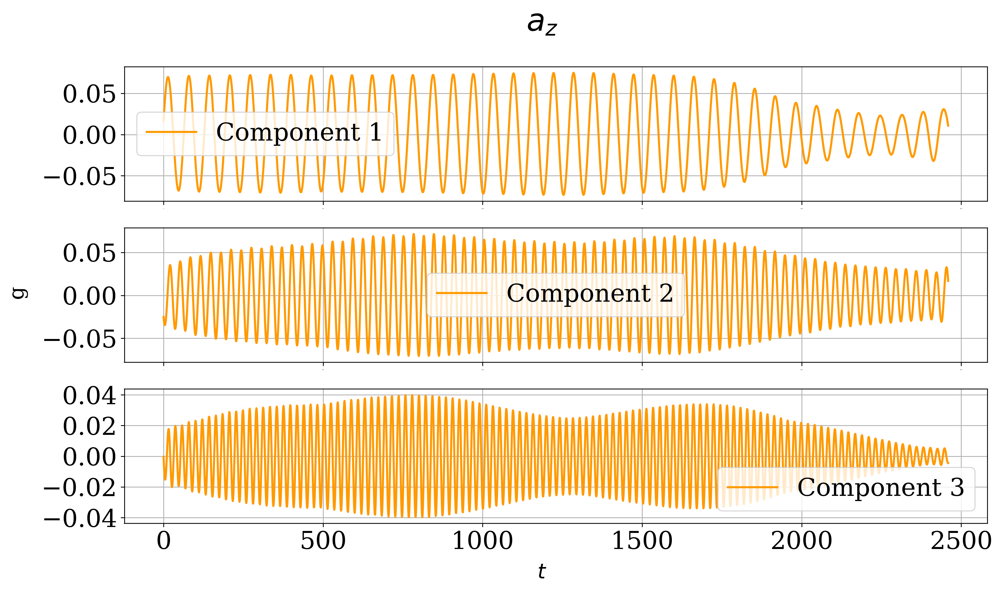

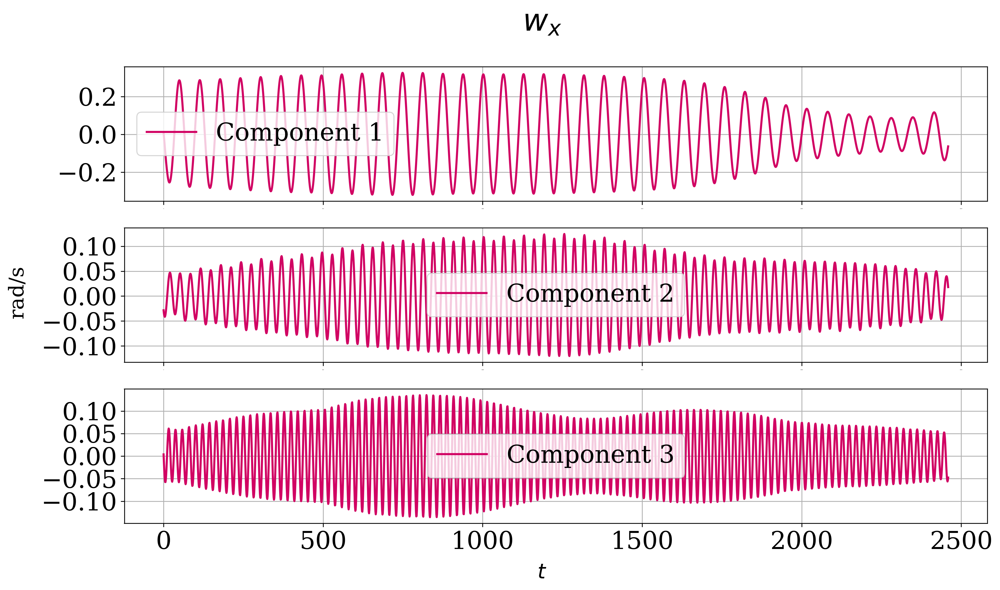

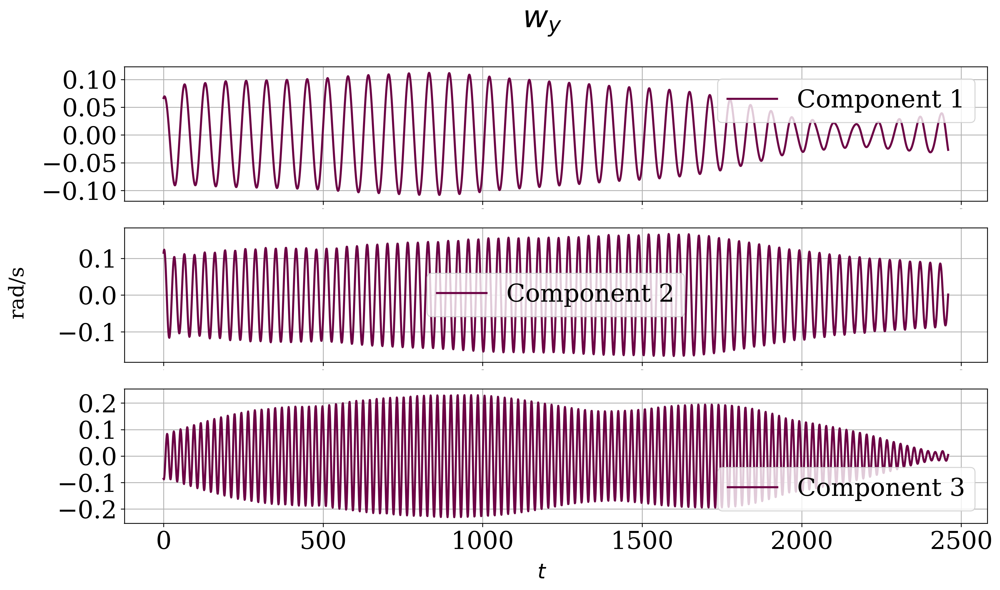

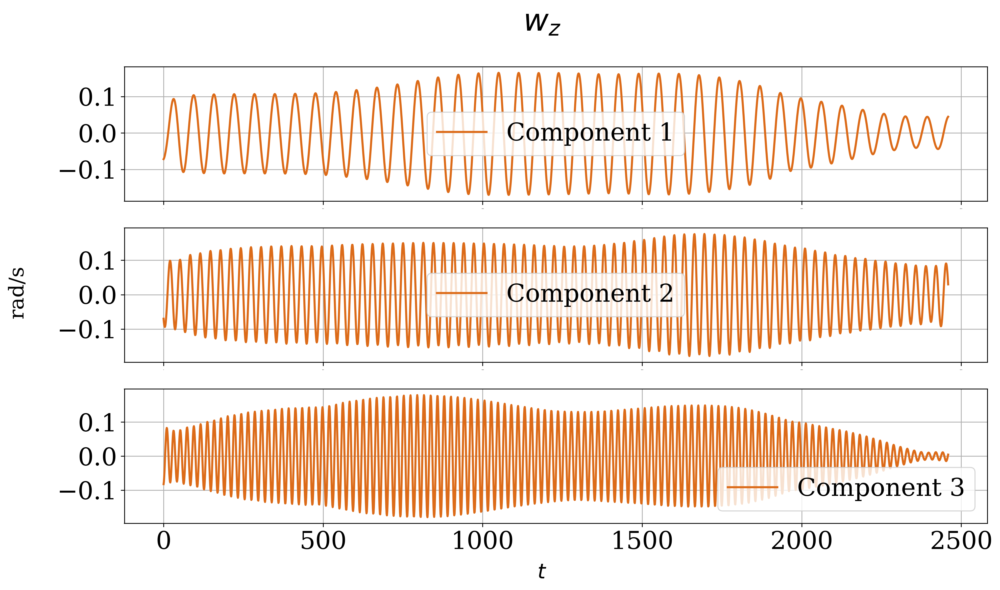

In [46]:
# every signal has the same grouping
my_grouping = [[[0, 1], [2, 3], [4, 5]] for _ in range(num_signals)]
my_grouping_id = 2

# save chosen grouping
#with open(f'./saved_grouping/manual/grouping_{my_grouping_id}.pkl', 'wb') as f:
#    pickle.dump(my_grouping, f)

component_figs = FitAndDescribe(my_grouping)

# make directory for figures for chosen grouping
pathlib.Path(f'./figs/decomposition/manual/grouping_{my_grouping_id}').mkdir(parents=True, exist_ok=True)

# save figures
for i in range(len(component_figs)):
    component_figs[i].savefig(
        f'./figs/decomposition/manual/grouping_{my_grouping_id}/{sig_names[i].replace(" ", "_")}.png',
        format='png'
    )

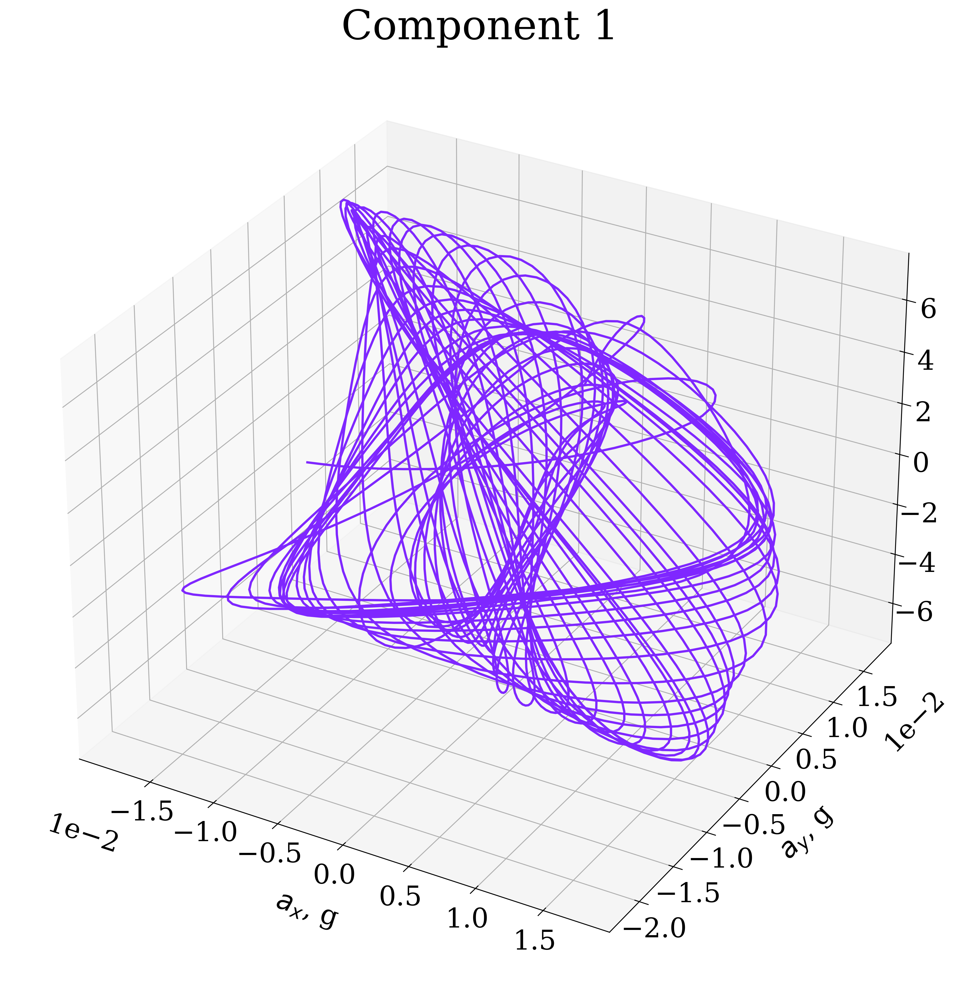

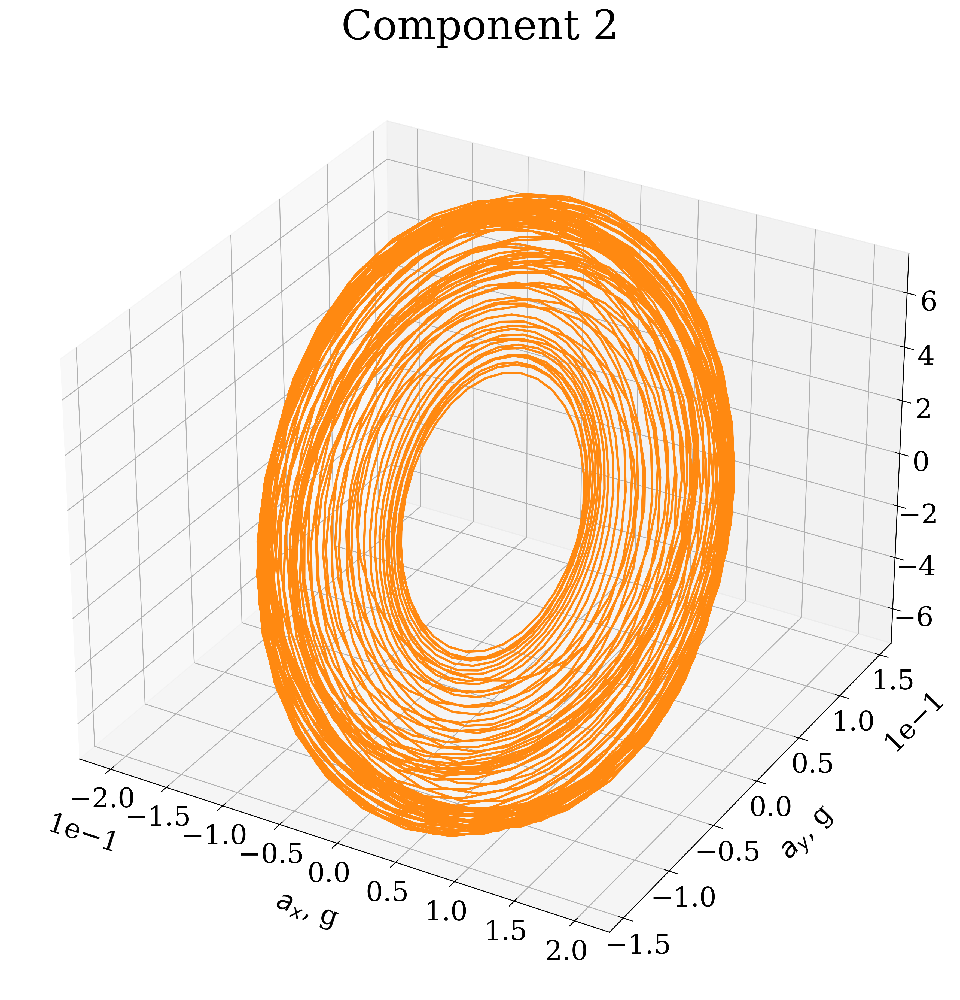

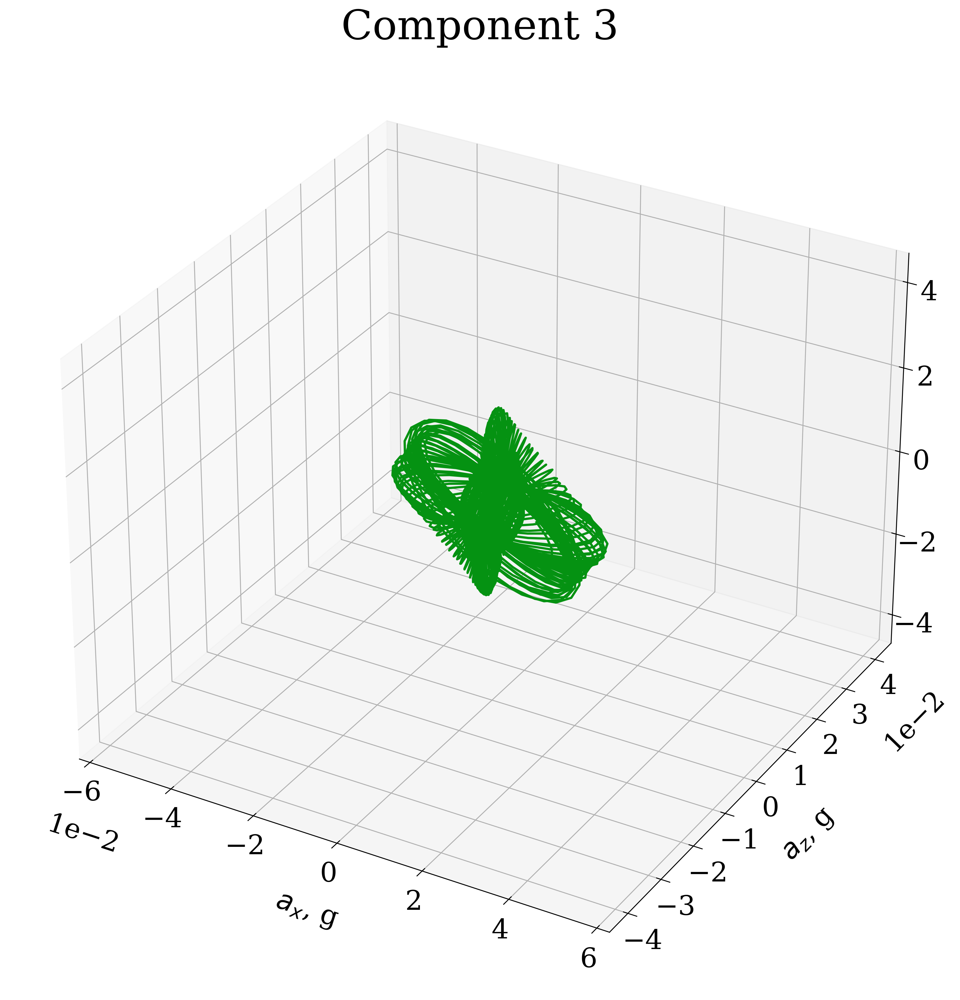

In [47]:
# plot 3d acceler results
component_colors = ["#7F27FF", "#FF8911", "#059212"]

for i in range(train_data.shape[1]):
    m_ssa_obj.set_factors_grouping(my_grouping[i], i)

comp_sigs, hank_resid_abs, hank_resid_rel = m_ssa_obj.decompose_signals()

with EnableJournalStylePlotting():
    num_components = len(my_grouping[0])
    for j in range(num_components):
        fig = plt.figure(figsize=(20, 15))
        ax = fig.add_subplot(projection='3d')

        component_points = np.array([comp_sigs[0][j], comp_sigs[1][j], comp_sigs[2][j]])

        if j == 2:
            ax.plot(*component_points, zdir="y", color=component_colors[j])

            ax.set_xlabel(f"{sig_names[0]}, {sig_units[0]}", labelpad=21)
            ax.set_ylabel(f"{sig_names[2]}, {sig_units[2]}", labelpad=21)
            ax.set_zlabel(f"{sig_names[1]}, {sig_units[1]}", labelpad=21)
            ax.set_title(f"Component {j + 1}")
        else:
            ax.plot(*component_points, color=component_colors[j])

            ax.set_xlabel(f"{sig_names[0]}, {sig_units[0]}", labelpad=21)
            ax.set_ylabel(f"{sig_names[1]}, {sig_units[1]}", labelpad=21)
            ax.set_zlabel(f"{sig_names[2]}, {sig_units[2]}", labelpad=21)
            ax.set_title(f"Component {j + 1}")

        for axis in ["x", "y", "z"]:
            ax.ticklabel_format(axis=axis, style="scientific", scilimits=(0, 0))
        
        fig.savefig(f"./figs/decomposition/manual/grouping_{my_grouping_id}/acceler_{j + 1}.png", format='png')

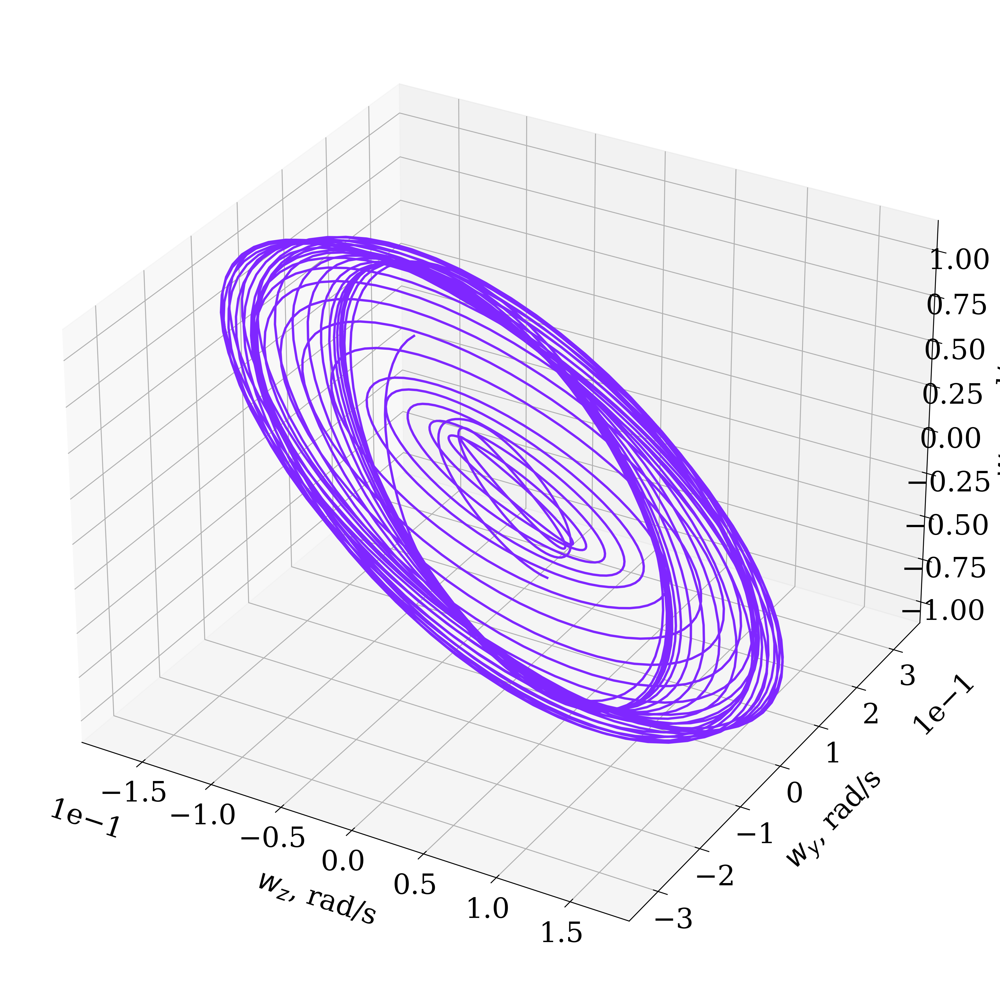

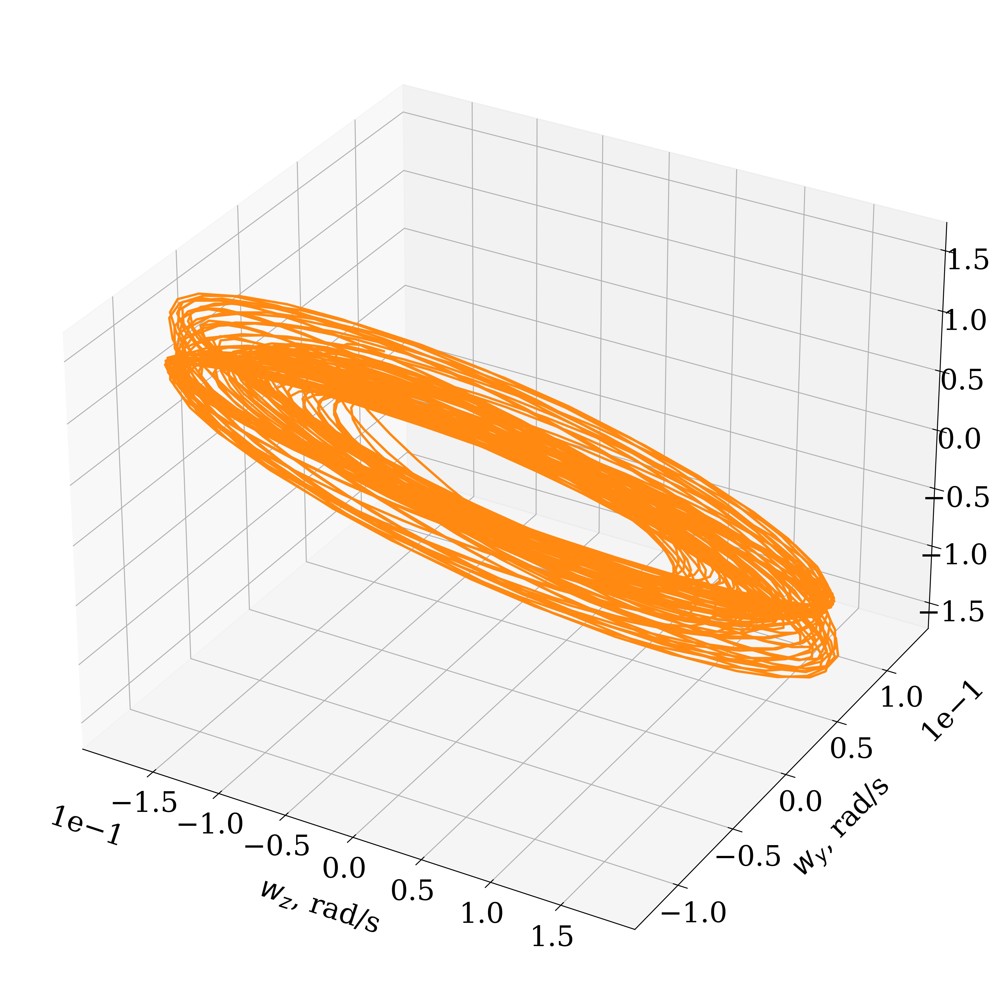

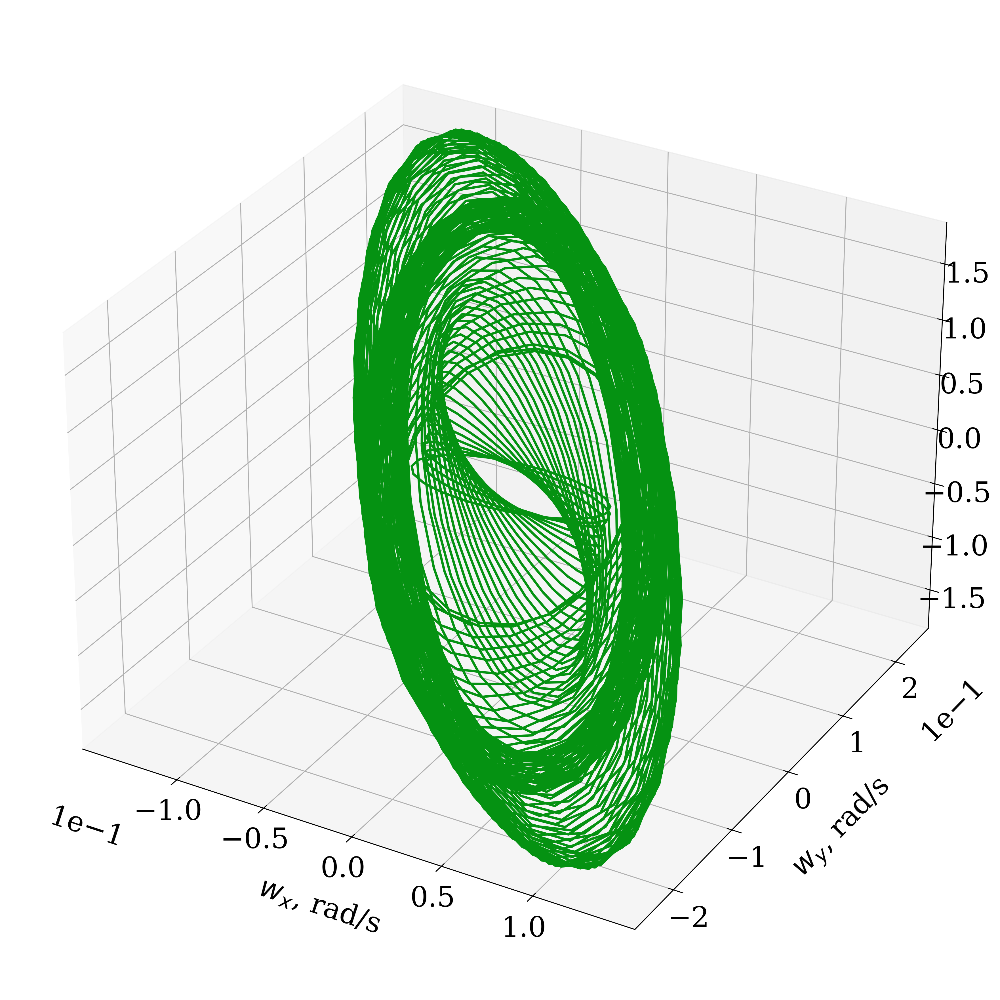

In [48]:
# plot 3d gyro results

with EnableJournalStylePlotting():
    num_components = len(comp_sigs[0])
    for j in range(num_components):
        fig = plt.figure(figsize=(20, 15))
        ax = fig.add_subplot(projection='3d')

        component_points = np.array([comp_sigs[3][j], comp_sigs[4][j], comp_sigs[5][j]])
        #component_points = component_points[:, :50]

        if j == 2:
            ax.plot(*component_points, color=component_colors[j])

            ax.set_xlabel(f"{sig_names[3]}, {sig_units[3]}", labelpad=21)
            ax.set_ylabel(f"{sig_names[4]}, {sig_units[4]}", labelpad=21)
            ax.set_zlabel(f"{sig_names[5]}, {sig_units[5]}", labelpad=21)
        else:
            ax.plot(*component_points, zdir="x", color=component_colors[j])
    
            ax.set_xlabel(f"{sig_names[5]}, {sig_units[5]}", labelpad=21)
            ax.set_ylabel(f"{sig_names[4]}, {sig_units[4]}", labelpad=21)
            ax.set_zlabel(f"{sig_names[3]}, {sig_units[3]}", labelpad=21)

        for axis in ["x", "y", "z"]:
            ax.ticklabel_format(axis=axis, style="scientific", scilimits=(0, 0))
        
        fig.savefig(f"./figs/decomposition/manual/grouping_{my_grouping_id}/gyro_{j + 1}.png", format='png')

## Prediction

In [49]:
# make directory for figures
pathlib.Path(f'./figs/prediction').mkdir(parents=True, exist_ok=True)

In [50]:
m_ssa_obj.remove_last_predictions()

# get prediction for cuurent number of factors left
forecast_mssa = np.empty(test_data.shape)

for i in range(test_data.shape[0]):
    forecast_mssa[i] = np.array(m_ssa_obj.predict_next())

# get MSE for every signal
signals_mse_mssa = np.mean((forecast_mssa - test_data) ** 2, axis=0)
# get MAPE for every signal
signals_mape_mssa = np.mean(np.abs((forecast_mssa - test_data) / test_data), axis=0)

print(f'MSE: {signals_mse_mssa}; Mean by signals = {np.mean(signals_mse_mssa):e}')
print(f'MAPE: {signals_mape_mssa}; Mean by signals = {np.mean(signals_mape_mssa)}')

MSE: [0.0660132  0.03209908 0.01560241 0.18683423 0.11932974 0.07674947]; Mean by signals = 8.277135e-02
MAPE: [1.48945967 1.34002824 3.31536761 1.7904028  1.77386321 1.82574017]; Mean by signals = 1.9224769490354994


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


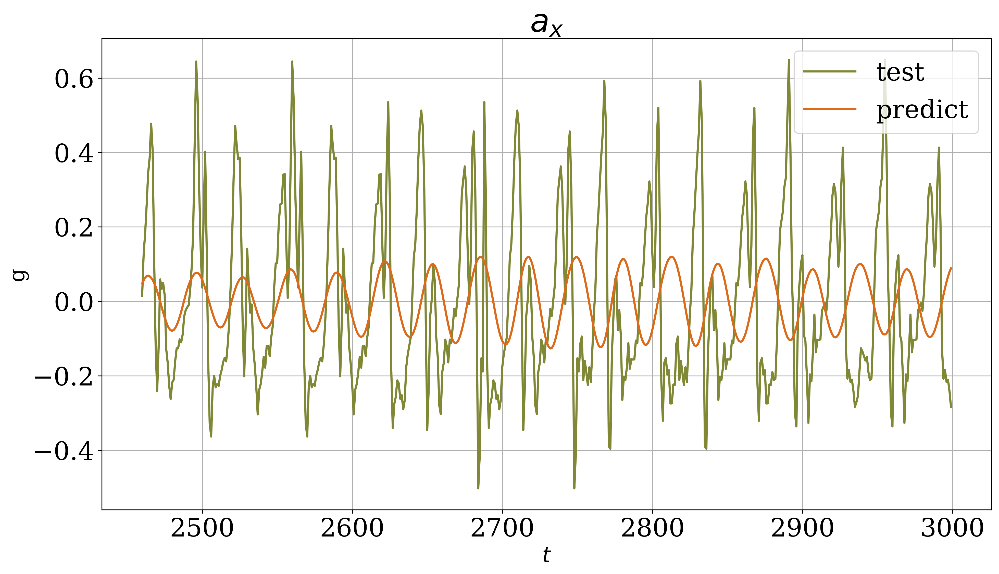

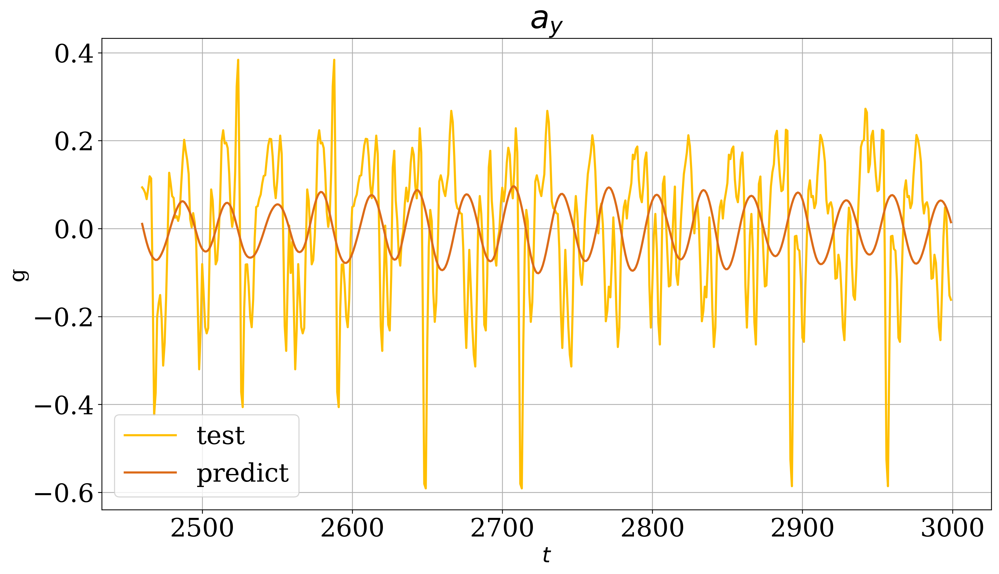

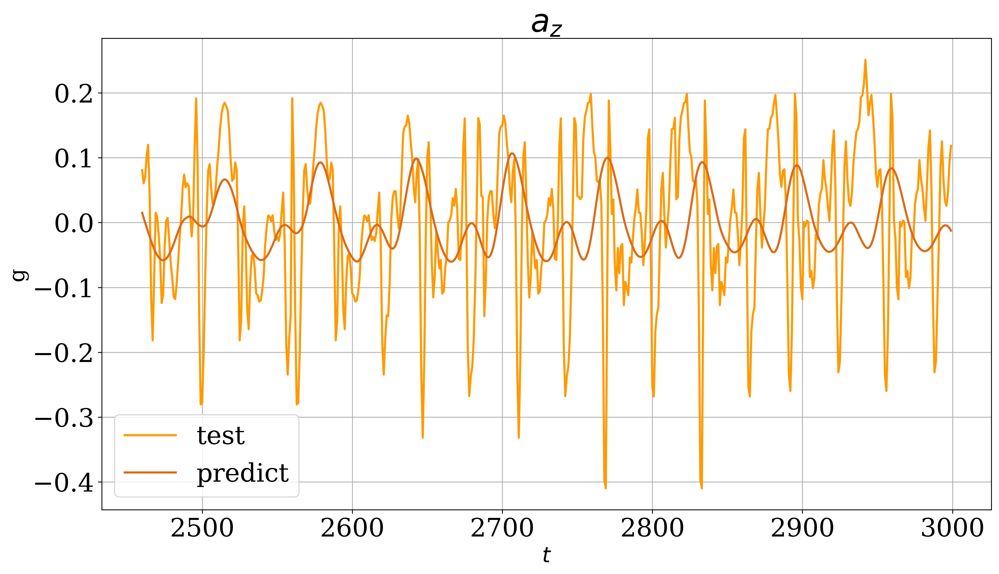

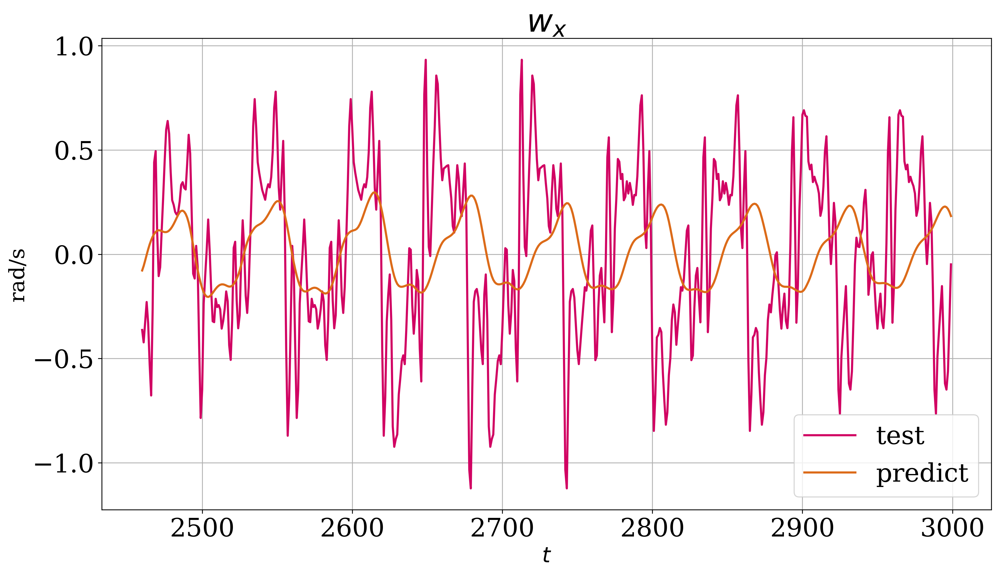

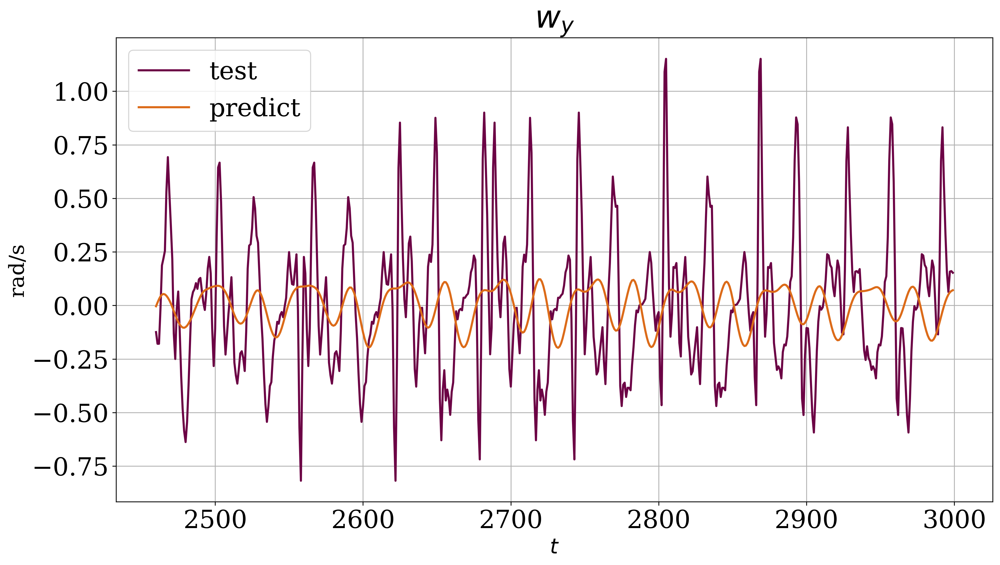

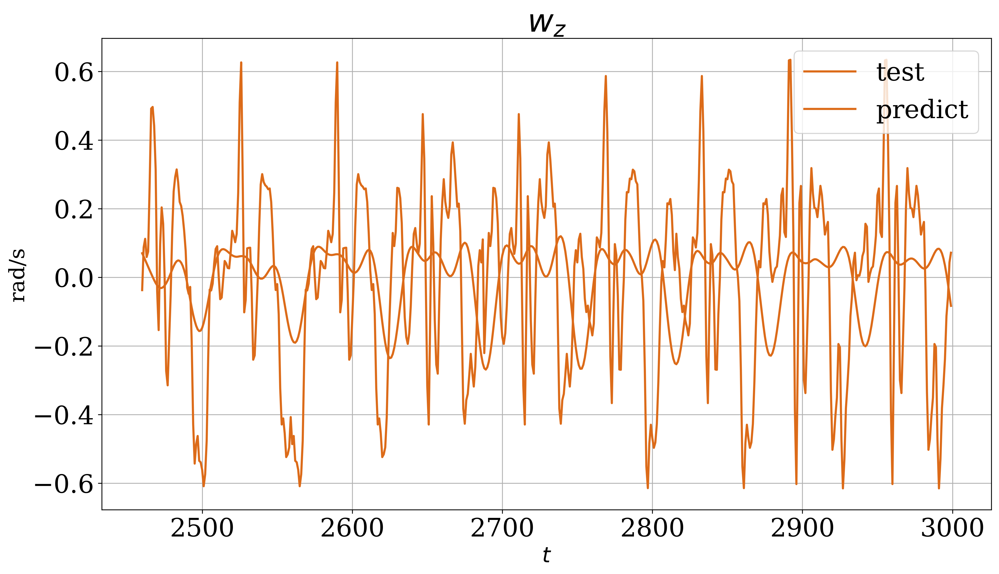

In [51]:
# plot prediction and real values
for i in range(num_signals):
    with EnableJournalStylePlotting():
        fig, ax = plt.subplots(figsize=(15, 8))

        ax.plot(time_grid_test, test_data.T[i], color=color_list[i], label='test')
        ax.plot(time_grid_test, forecast_mssa.T[i], color=color_list[-1], label='predict')

        ax.grid(True)
        ax.legend();
        ax.set_ylabel(f'{sig_units[i]}', fontsize=20)
        ax.set_xlabel('$t$', fontsize=20)
        ax.set_title(f'{sig_names[i]}', fontsize=30)

        fig.savefig(f'./figs/prediction/{sig_names[i].replace(" ", "_")}.eps',
                             format='eps')

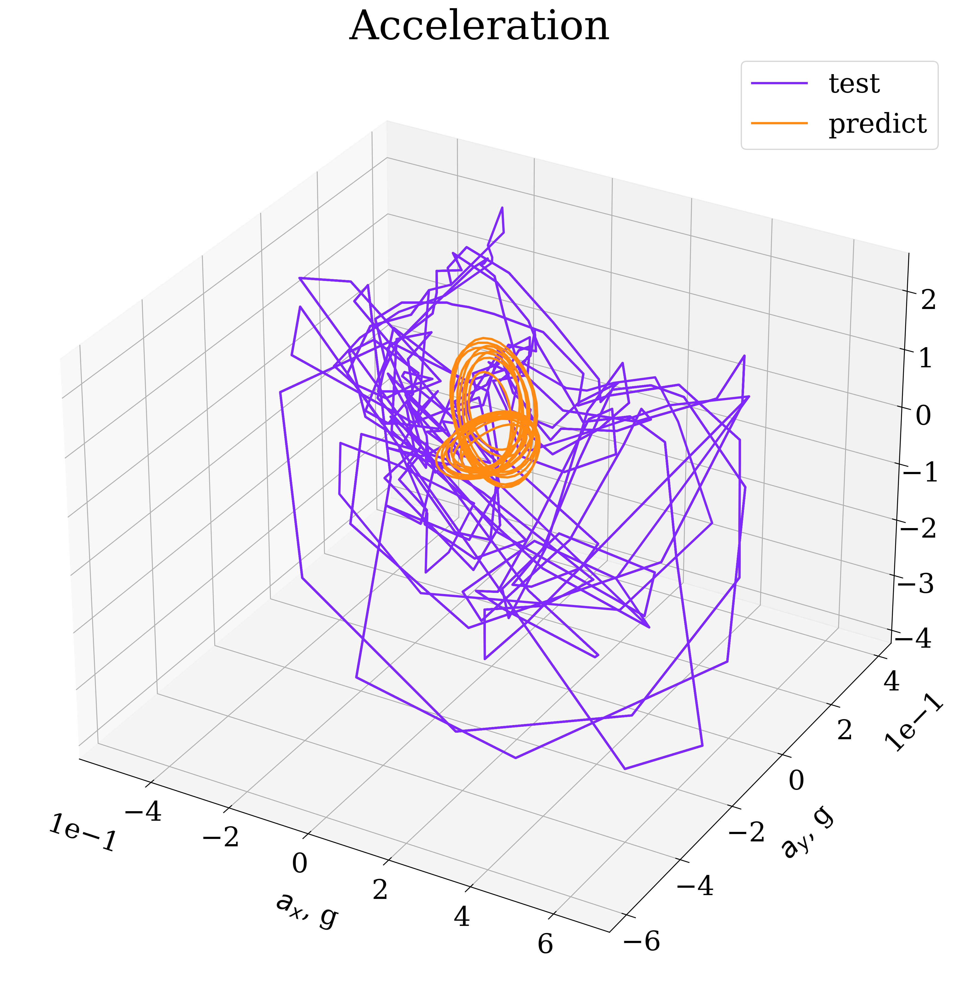

In [52]:
component_colors = ["#7F27FF", "#FF8911"]

with EnableJournalStylePlotting():
    fig = plt.figure(figsize=(20, 15))
    ax = fig.add_subplot(projection='3d')

    ax.plot(*(test_data.T[:3]), color=component_colors[0], label="test")
    ax.plot(*(forecast_mssa.T[:3]), color=component_colors[1], label="predict")

    ax.set_xlabel(f"{sig_names[0]}, {sig_units[0]}", labelpad=21)
    ax.set_ylabel(f"{sig_names[1]}, {sig_units[1]}", labelpad=21)
    ax.set_zlabel(f"{sig_names[2]}, {sig_units[2]}", labelpad=21)
    ax.set_title(f"Acceleration")
    ax.legend()

    for axis in ["x", "y", "z"]:
        ax.ticklabel_format(axis=axis, style="scientific", scilimits=(0, 0))
    
    fig.savefig(f"./figs/prediction/acceler.png", format='png')

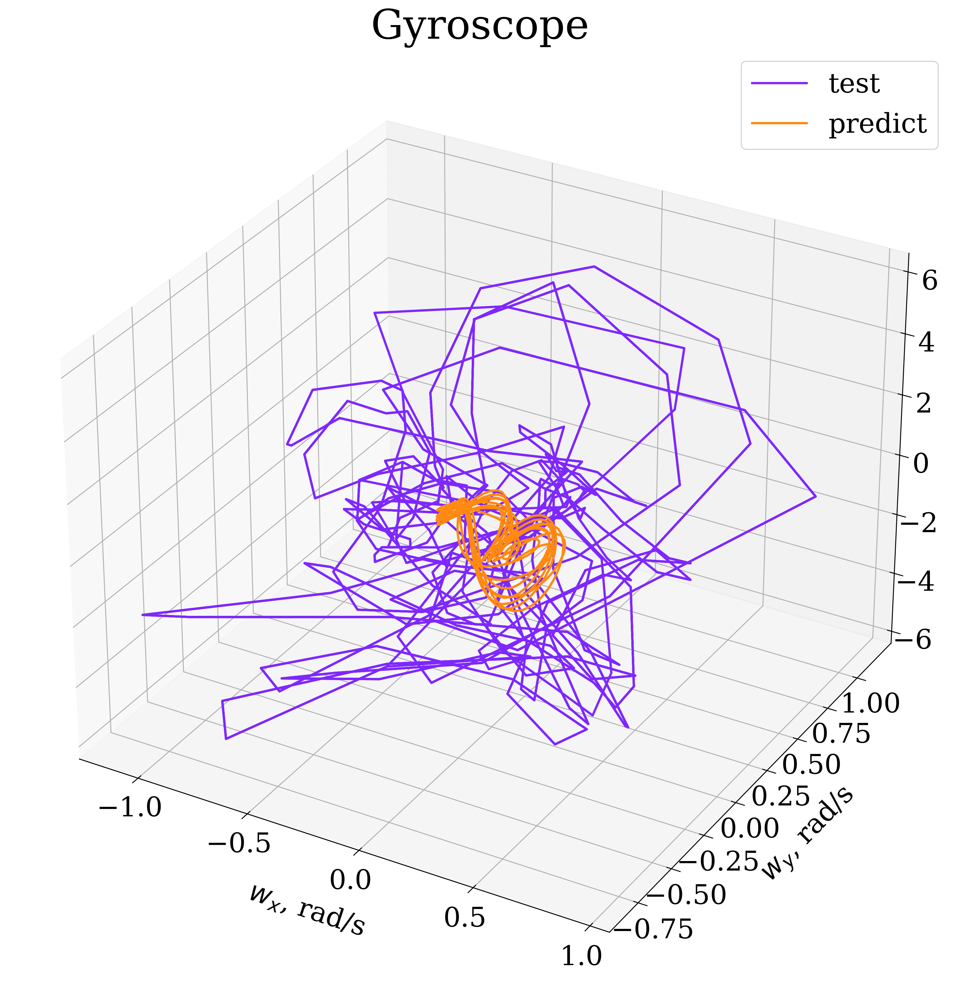

In [53]:
with EnableJournalStylePlotting():
    fig = plt.figure(figsize=(20, 15))
    ax = fig.add_subplot(projection='3d')

    ax.plot(*(test_data.T[3:]), color=component_colors[0], label="test")
    ax.plot(*(forecast_mssa.T[3:]), color=component_colors[1], label="predict")

    ax.set_xlabel(f"{sig_names[3]}, {sig_units[3]}", labelpad=21)
    ax.set_ylabel(f"{sig_names[4]}, {sig_units[4]}", labelpad=21)
    ax.set_zlabel(f"{sig_names[5]}, {sig_units[5]}", labelpad=21)
    ax.set_title(f"Gyroscope")
    ax.legend()

    for axis in ["x", "y", "z"]:
        ax.ticklabel_format(axis=axis, style="scientific", scilimits=(0, 0))
    
    fig.savefig(f"./figs/prediction/gyro.png", format='png')